In [194]:
import keras
import pandas as pd
import numpy as np
from keras.layers import *
from keras.activations import *
from keras.callbacks import *
from keras.optimizers import *
from keras.models import *
import matplotlib.pyplot as plt
from keras.utils import to_categorical
from sklearn.preprocessing import MinMaxScaler
from scipy import signal
import stldecompose

In [195]:
data_orig = pd.read_csv('../data/files/multiple_concatenated_tickers.csv')
data_orig.tail()

,Index,QQQ.Open,QQQ.High,QQQ.Low,QQQ.Close,QQQ.Volume,QQQ.Adjusted,TSLA.Open,TSLA.High,TSLA.Low,...,ZAR.X.Low,ZAR.X.Close,ZAR.X.Volume,ZAR.X.Adjusted,RUB.X.Open,RUB.X.High,RUB.X.Low,RUB.X.Close,RUB.X.Volume,RUB.X.Adjusted
992,2019-06-04,172.029999,174.970001,171.369995,174.910004,47797800,174.910004,181.100006,193.979996,179.610001,...,14.6112,14.6273,0,14.6273,65.116699,65.343002,64.935699,65.129997,0,65.129997
993,2019-06-05,176.580002,176.610001,174.380005,176.210007,34412700,176.210007,198.679993,201.279999,191.850006,...,14.8321,14.8352,0,14.8352,65.287102,65.328003,65.008003,65.278503,0,65.278503
994,2019-06-06,176.509995,178.039993,175.729996,177.610001,29913200,177.610001,204.440002,211.000000,201.800003,...,14.8953,15.0037,0,15.0037,65.045197,65.136002,64.732002,65.032799,0,65.032799
995,2019-06-07,178.559998,181.770004,178.330002,181.039993,45868600,181.039993,205.000000,210.839996,203.500000,...,0.0000,0.0000,0,0.0000,0.000000,0.000000,0.000000,0.000000,0,0.000000
996,2019-06-08,0.000000,0.000000,0.000000,0.000000,0,0.000000,0.000000,0.000000,0.000000,...,0.0000,0.0000,0,0.0000,0.000000,0.000000,0.000000,0.000000,0,0.000000


In [196]:
vol_data_orig = pd.read_csv('../data/files/multiple_concatenated_tickers_volatility.csv')
vol_data_orig.tail()

,Index,volatilityQQQ,volatilityTSLA,volatilityMSFT,volatilityINTC,volatilityAAPL,volatilityNFLX,volatilityAMZN,volatilityFB,volatilityGOOG,...,volatilityHKD=X,volatilitySGD=X,volatilityINR=X,volatilityMXN=X,volatilityPHP=X,volatilityIDR=X,volatilityTHB=X,volatilityMYR=X,volatilityZAR=X,volatilityRUB=X
992,2019-06-04,0.236161,0.628139,0.268701,0.281585,0.277755,0.378624,0.333670,0.491539,0.356938,...,0.008461,0.043859,0.082009,0.141995,0.082401,0.068891,0.052323,0.030123,0.173064,0.078079
993,2019-06-05,0.244384,0.536080,0.297374,0.276320,0.277110,0.369766,0.337870,0.492750,0.350358,...,0.008465,0.044029,0.082456,0.145289,0.077390,0.069230,0.057071,0.030085,0.181973,0.069414
994,2019-06-06,0.237914,0.585434,0.303501,0.276694,0.265918,0.349971,0.331952,0.488919,0.357443,...,0.008471,0.042626,0.071099,0.150609,0.070007,0.066401,0.057093,0.043426,0.181317,0.062928
995,2019-06-07,0.260007,0.561922,0.334232,0.294798,0.287668,0.352532,0.372499,0.528088,0.393389,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
996,2019-06-08,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [197]:
data_orig = data_orig\
  .merge(vol_data_orig, how="inner", left_on=data_orig.Index, right_on=vol_data_orig.Index).fillna(method="ffill")\
  .drop(["key_0", "Index_y"], axis=1)

In [198]:
[i for i in list(data_orig.columns) if 'Index' in i]

['Index_x']

In [199]:
list(data_orig.columns)

['Index_x',
 'QQQ.Open',
 'QQQ.High',
 'QQQ.Low',
 'QQQ.Close',
 'QQQ.Volume',
 'QQQ.Adjusted',
 'TSLA.Open',
 'TSLA.High',
 'TSLA.Low',
 'TSLA.Close',
 'TSLA.Volume',
 'TSLA.Adjusted',
 'MSFT.Open',
 'MSFT.High',
 'MSFT.Low',
 'MSFT.Close',
 'MSFT.Volume',
 'MSFT.Adjusted',
 'INTC.Open',
 'INTC.High',
 'INTC.Low',
 'INTC.Close',
 'INTC.Volume',
 'INTC.Adjusted',
 'AAPL.Open',
 'AAPL.High',
 'AAPL.Low',
 'AAPL.Close',
 'AAPL.Volume',
 'AAPL.Adjusted',
 'NFLX.Open',
 'NFLX.High',
 'NFLX.Low',
 'NFLX.Close',
 'NFLX.Volume',
 'NFLX.Adjusted',
 'AMZN.Open',
 'AMZN.High',
 'AMZN.Low',
 'AMZN.Close',
 'AMZN.Volume',
 'AMZN.Adjusted',
 'FB.Open',
 'FB.High',
 'FB.Low',
 'FB.Close',
 'FB.Volume',
 'FB.Adjusted',
 'GOOG.Open',
 'GOOG.High',
 'GOOG.Low',
 'GOOG.Close',
 'GOOG.Volume',
 'GOOG.Adjusted',
 'SQ.Open',
 'SQ.High',
 'SQ.Low',
 'SQ.Close',
 'SQ.Volume',
 'SQ.Adjusted',
 'TWTR.Open',
 'TWTR.High',
 'TWTR.Low',
 'TWTR.Close',
 'TWTR.Volume',
 'TWTR.Adjusted',
 'DATA.Open',
 'DATA.High',


In [200]:
# data_orig.drop(['Index_x'], axis=1, inplace=True)

In [201]:
import pickle
import os
from keras.preprocessing import *
from nltk.stem import SnowballStemmer
from dateutil.parser import parse
from datetime import datetime

data = []
for i in os.listdir("../briefings/"):
    #print(i)
    f = open("../briefings/"+str(i), "rb")
    d = pickle.loads(f.read())
    data.append(d)

#Headlines
headlines = []
text_bodies = []
all_text = []
dates = []
snow = SnowballStemmer('english')
for i,v in enumerate(data):
    for k in v:
        #print(k["date"], k["headline"])
        if k["date"] == -1:
            continue
        w = parse(k["date"])
        headlines.append(''.join([snow.stem(w) for w in str(k["headline"])]))
        text_bodies.append(''.join([snow.stem(w) for w in str(k["text"])]))
        all_text.append(''.join([snow.stem(w) for w in str(k["headline"])]))
        dates.append(w.date().isoformat())
        all_text.append(''.join([snow.stem(w) for w in str(k["text"])]))
        dates.append(w.date().isoformat())

tokenizer = text.Tokenizer(num_words=5000, filters='!"#$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n', lower=True, split=' ', char_level=False, oov_token=None)

In [202]:
tokenizer.fit_on_texts(all_text)
encoded_docs = tokenizer.texts_to_matrix(all_text, mode='tfidf')
tfidf_df = pd.DataFrame(encoded_docs)
tfidf_df["DATE"] = dates
tfidf_docs = tfidf_df.groupby(['DATE'], as_index=True).mean()

In [203]:
data_orig.set_index("Index_x", inplace=True)
data_orig = data_orig.merge(tfidf_docs, how="left", left_on=data_orig.index, right_on=tfidf_docs.index).fillna(method="ffill").rename(columns={'key_0': 'Index'}).set_index("Index")

In [148]:
# list(data_orig.columns)
# [i for i in list(data_orig.columns) if str(i).isdigit()]

In [149]:
# ticker_lookup = dict([(i[1].split('.')[0], int(i[0])) for i in enumerate(list(data_orig.columns)) if (('Open' in str(i[1])) or ("volatility" in str(i[1]) ))])
# ticker_lookup

{}

In [209]:
days_lookback = 1
# pct_df = data_orig.iloc[:,0:].shift(days_lookback).fillna(-1)
pct_df = data_orig.iloc[:,0:].pct_change(periods=days_lookback).applymap(lambda x: 1 if x > 0.02 else 0)
# pct_df = pct_df[["QQQ.Open", "volatilityQQQ"]]

In [210]:
data_orig = data_orig.filter(items=[i for i in list(data_orig.columns) if str(i).isdigit()])

In [211]:
inv_map = {v+'.Open': k for k, v in dict(enumerate(list(ticker_lookup.keys()))).items()}
inv_map

{}

In [212]:
set(data_orig.columns).difference(set(pct_df.columns))

set()

In [217]:
# De-trend data
data_orig_detrended = signal.detrend(data_orig.fillna(method="ffill").fillna(-1))

# Normalized
# scaler = MinMaxScaler(feature_range=(0, 1))
# data_mat = scaler.fit_transform(data_orig_detrended)
# pctdf_mat = scaler.fit_transform(pct_df)

# Non-normalized version
data_mat = data_orig_detrended
pctdf_mat = pctdf_mat

In [218]:
seq_len = 90 # days to use for prediction
data = np.array((data_mat))

In [219]:
sequence_length = seq_len + 1
result = []
for index in range(len(data) - sequence_length):
    result.append(data[index: index + sequence_length])

result = np.array(result)

row = round(0.9 * result.shape[0])
train = result[:int(row), :] # Create training set

In [220]:
# np.random.shuffle(train)
x_train = result[:int(row), :]
y_train = pctdf_mat[:int(row)] # Needs to be N-day shift
x_test = result[int(row):, :]
y_test = pctdf_mat[int(row):]  # Needs to be N-day shift

[x_train, y_train, x_test, y_test]

[array([[[-4.44089210e-16, -4.44089210e-16, -4.44089210e-16, ...,
          -4.44089210e-16, -4.44089210e-16, -4.44089210e-16],
         [-1.35866768e-01,  1.64848421e+00,  8.34005211e-01, ...,
           4.75365386e-02,  4.75732413e-02,  4.76099440e-02],
         [-1.27948031e-01,  1.60506555e+00,  1.57969108e+00, ...,
           4.52442542e-02,  4.52789135e-02,  4.53135727e-02],
         ...,
         [-1.80137207e-01,  1.78612121e+00,  1.55388014e+00, ...,
           6.16251066e-02,  6.16734881e-02,  6.17218696e-02],
         [-1.87331341e-01,  1.79972646e+00,  1.56785963e+00, ...,
           6.32259854e-02,  6.32761270e-02,  6.33262685e-02],
         [-2.06069161e-01,  1.86627082e+00,  1.60556871e+00, ...,
           6.80465057e-02,  6.81013617e-02,  6.81562178e-02]],
 
        [[-1.35866768e-01,  1.64848421e+00,  8.34005211e-01, ...,
           4.75365386e-02,  4.75732413e-02,  4.76099440e-02],
         [-1.27948031e-01,  1.60506555e+00,  1.57969108e+00, ...,
           4.52442542

In [221]:
LAYERS = 100
model = Sequential()

# Original Architecture
model.add(LSTM(
    input_dim=data.shape[1],
    output_dim=LAYERS,
    return_sequences=True))
model.add(BatchNormalization())
model.add(LSTM(
    LAYERS,
    return_sequences=False))
model.add(Dropout(0.25))
model.add(Dense(output_dim=y_train.shape[1]))
model.add(Activation('sigmoid'))

start = time.time()
model.compile(loss='binary_crossentropy', optimizer="adam")
print('compilation time : ', time.time() - start)

/usr/local/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: UserWarning: The `input_dim` and `input_length` arguments in recurrent layers are deprecated. Use `input_shape` instead.
  
/usr/local/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: UserWarning: Update your `LSTM` call to the Keras 2 API: `LSTM(return_sequences=True, input_shape=(None, 500..., units=100)`
  


compilation time :  0.06326818466186523


/usr/local/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(units=2)`
  


In [222]:
MODELNAME = 'briefing_nlp'
earlyStopping = EarlyStopping(monitor='val_loss', patience=200, verbose=0, mode='min')
mcp_save = ModelCheckpoint('./models/'+MODELNAME+'_best.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=150, verbose=1, epsilon=1e-4, mode='min')
tbrd = TensorBoard(log_dir="./logs/"+MODELNAME, histogram_freq=0, batch_size=128, write_graph=True, write_grads=False, write_images=False, embeddings_freq=0, embeddings_layer_names=None, embeddings_metadata=None, embeddings_data=None, update_freq='epoch')
os.makedirs("./logs/"+MODELNAME)

/usr/local/anaconda3/lib/python3.6/site-packages/keras/callbacks.py:1065: UserWarning: `epsilon` argument is deprecated and will be removed, use `min_delta` instead.
  warnings.warn('`epsilon` argument is deprecated and '


FileExistsError: [Errno 17] File exists: './logs/briefing_nlp'

In [227]:
# Function to display the target and prediciton
def testmodel(epoch, logs):
    days = 5
    t = "QQQ"
    plt.style.use('fivethirtyeight')
    plt.title(t+" "+str(epoch))
    plt.plot([i[0] for i in model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))])
    plt.xticks(np.arange(5), ('M', 'T', 'W', 'Th', 'F'))
    plt.show()

    plt.title("Volatility "+t)
    plt.plot([i[1] for i in model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))])
    plt.xticks(np.arange(5), ('M', 'T', 'W', 'Th', 'F'))
    plt.show()

testmodelcb = keras.callbacks.LambdaCallback(on_epoch_end=testmodel)

/usr/local/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: UserWarning: The `nb_epoch` argument in `fit` has been renamed `epochs`.
  # This is added back by InteractiveShellApp.init_path()


Train on 733 samples, validate on 82 samples
Epoch 1/5000
733/733 [==============================] - 22s 31ms/step - loss: 0.2504 - val_loss: 0.6136


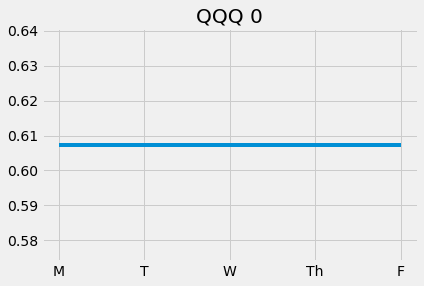

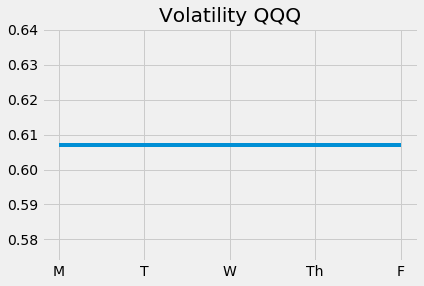

Epoch 2/5000
733/733 [==============================] - 21s 28ms/step - loss: 0.2303 - val_loss: 0.6150


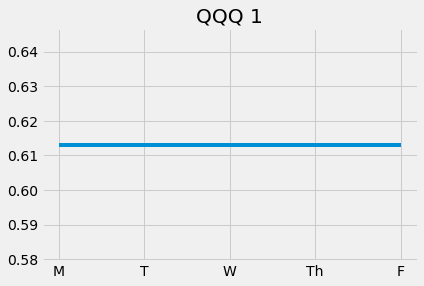

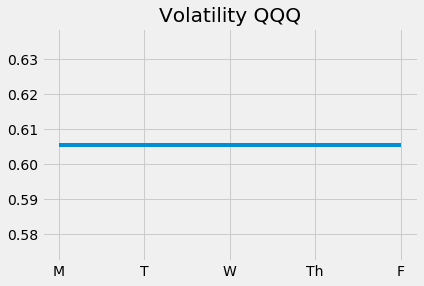

Epoch 3/5000
733/733 [==============================] - 22s 29ms/step - loss: 0.2035 - val_loss: 0.6256


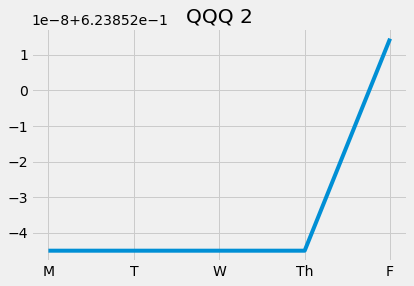

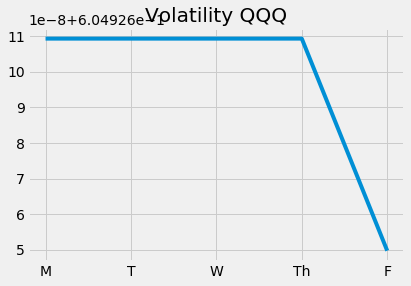

Epoch 4/5000
733/733 [==============================] - 21s 29ms/step - loss: 0.1802 - val_loss: 0.6337


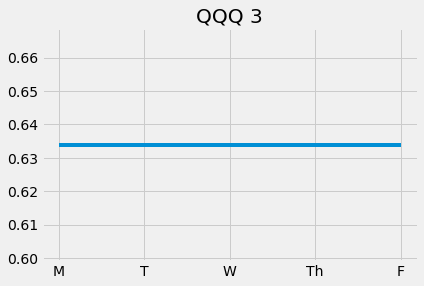

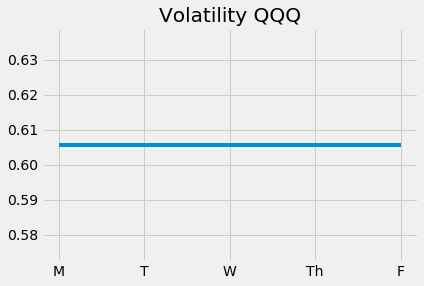

Epoch 5/5000
733/733 [==============================] - 22s 30ms/step - loss: 0.1612 - val_loss: 0.6434


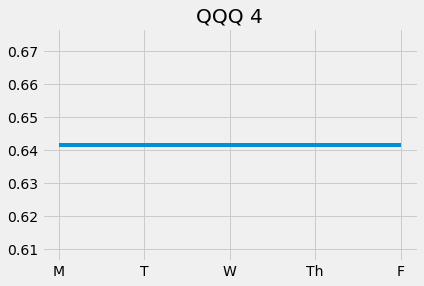

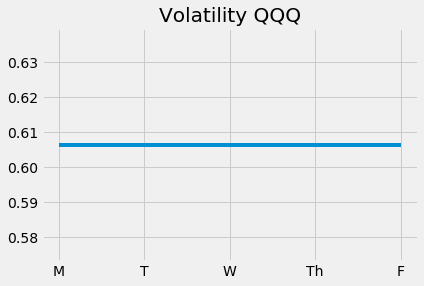

Epoch 6/5000
733/733 [==============================] - 19s 26ms/step - loss: 0.1458 - val_loss: 0.6514


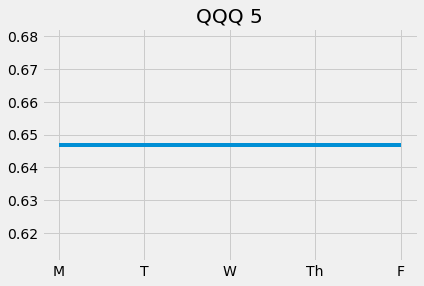

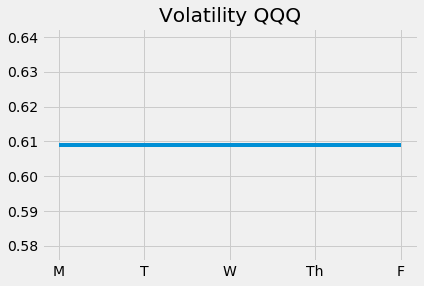

Epoch 7/5000
733/733 [==============================] - 22s 30ms/step - loss: 0.1279 - val_loss: 0.6679


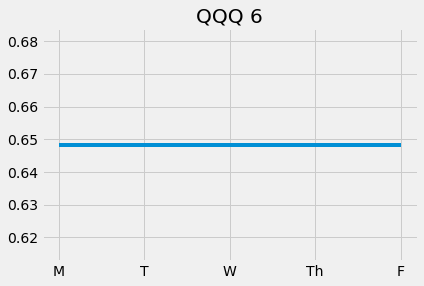

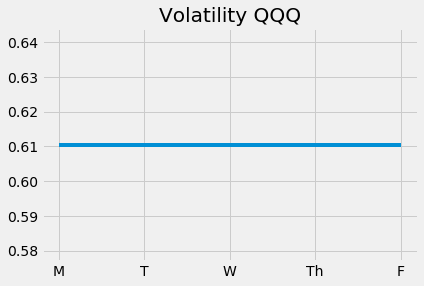

Epoch 8/5000
733/733 [==============================] - 23s 32ms/step - loss: 0.1179 - val_loss: 0.6804


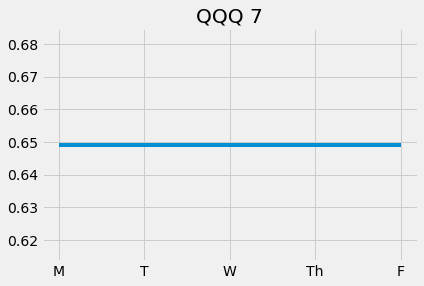

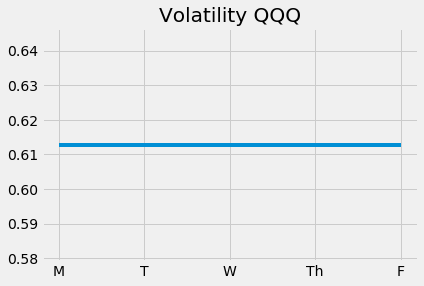

Epoch 9/5000
733/733 [==============================] - 21s 28ms/step - loss: 0.1073 - val_loss: 0.6913


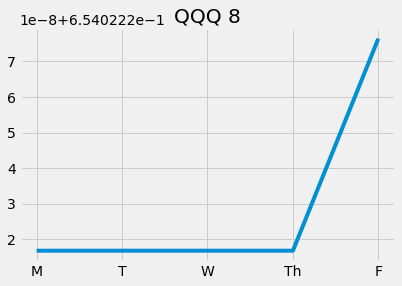

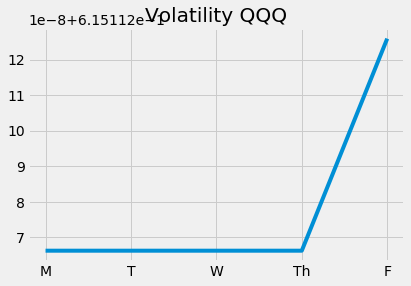

Epoch 10/5000
733/733 [==============================] - 21s 29ms/step - loss: 0.1005 - val_loss: 0.7098


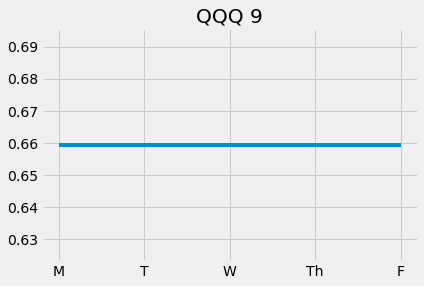

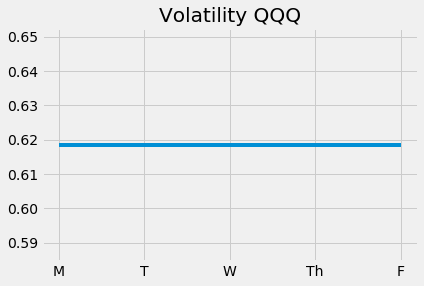

Epoch 11/5000
733/733 [==============================] - 22s 29ms/step - loss: 0.0897 - val_loss: 0.7312


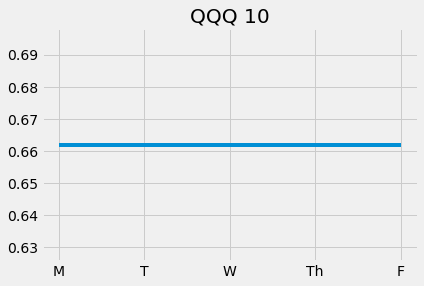

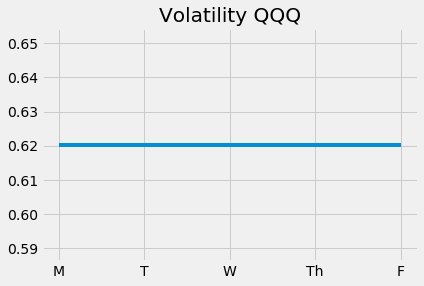

Epoch 12/5000
733/733 [==============================] - 21s 29ms/step - loss: 0.0868 - val_loss: 0.7389


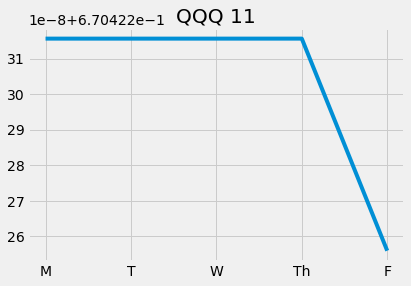

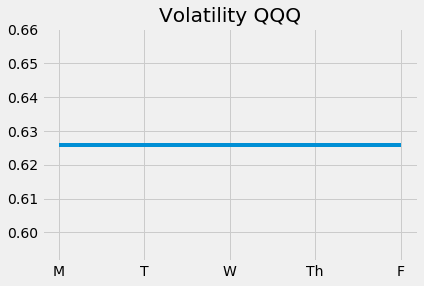

Epoch 13/5000
733/733 [==============================] - 23s 31ms/step - loss: 0.0761 - val_loss: 0.7442


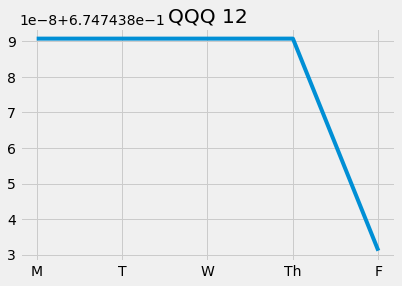

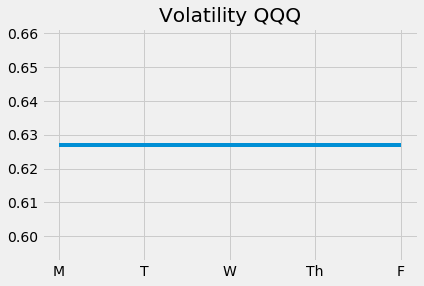

Epoch 14/5000
733/733 [==============================] - 25s 35ms/step - loss: 0.0704 - val_loss: 0.7621


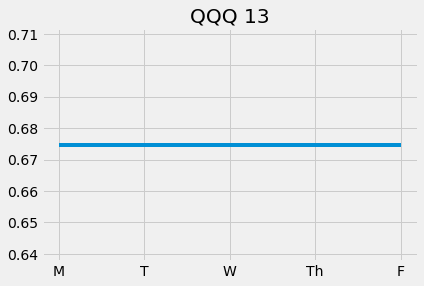

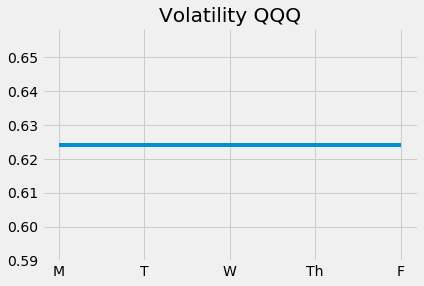

Epoch 15/5000
733/733 [==============================] - 22s 30ms/step - loss: 0.0635 - val_loss: 0.7651


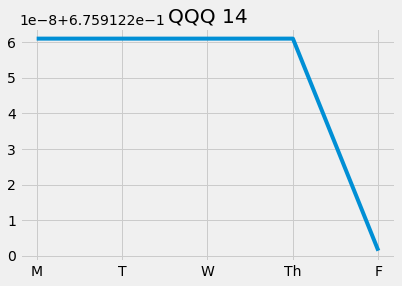

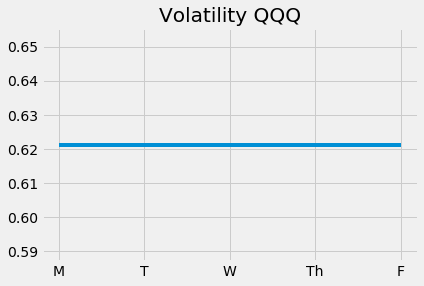

Epoch 16/5000


KeyboardInterrupt: 

In [230]:
VALIDATIONSIZE = 0.10
EPOCHS = 5000
# model = keras.models.load_model('./models/'+MODELNAME+'_best.hdf5') 
history = model.fit(
    x_train,
    y_train,
    batch_size=256,
    nb_epoch=EPOCHS,
    validation_split=VALIDATIONSIZE,
    callbacks = [reduce_lr_loss, earlyStopping, mcp_save, tbrd, testmodelcb],
    shuffle=True)

In [231]:
best_model = keras.models.load_model('./models/'+MODELNAME+'_best.hdf5') 

In [253]:
# best_model.predict(result).shape  (906, 2)
# x_train.shape (815, 91, 5000)
# x_test.shape (91, 91, 5000)
# result.shape (906, 91, 5000)

(906, 91, 5000)

In [190]:
# 5 refers to days of data. 5 days worth. each 1 row has 36 features
days = 5

In [191]:
import datetime

now = datetime.datetime.now()

In [192]:
# best_model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))
# np.reshape(data[-days:], (days, 1, data.shape[1])).shape

best_model.predict(x_test[-days:])

array([[0.12953316, 0.39627483],
       [0.13006814, 0.39519787],
       [0.130509  , 0.3949232 ],
       [0.13085309, 0.394997  ],
       [0.13111387, 0.39519578]], dtype=float32)

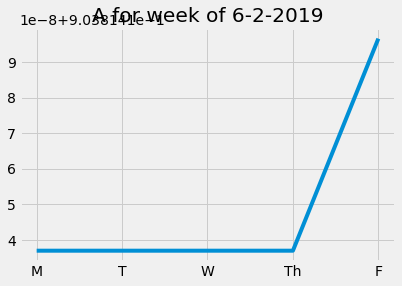

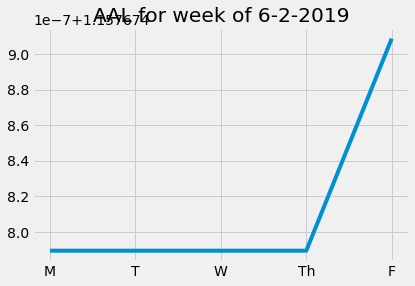

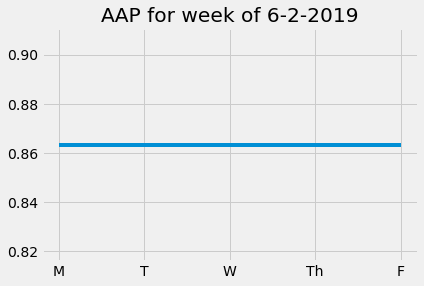

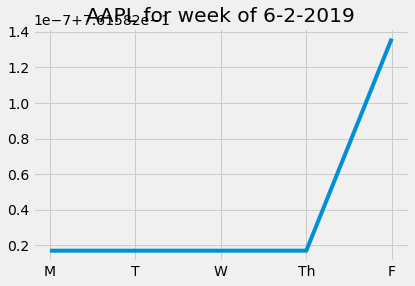

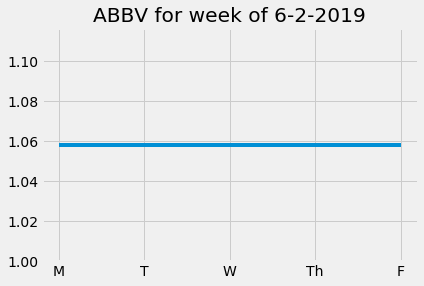

...

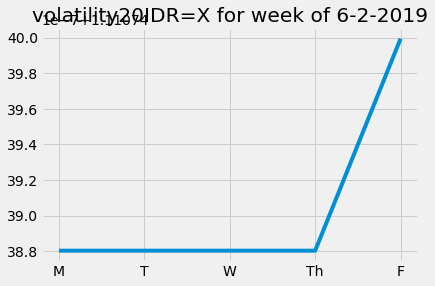

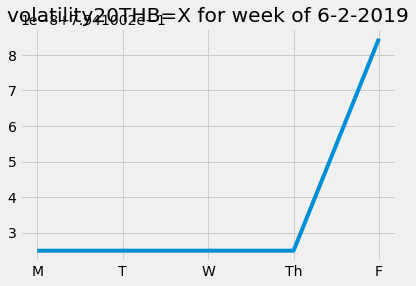

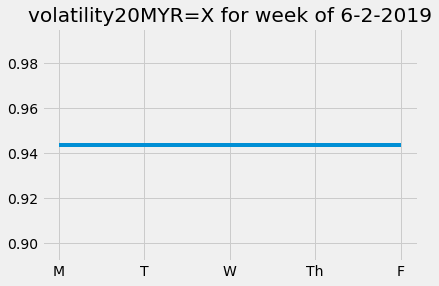

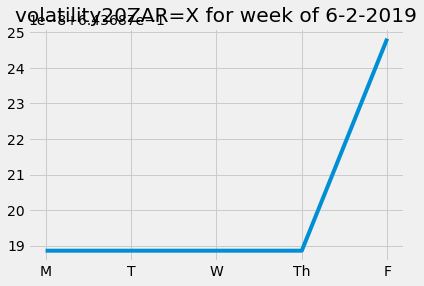

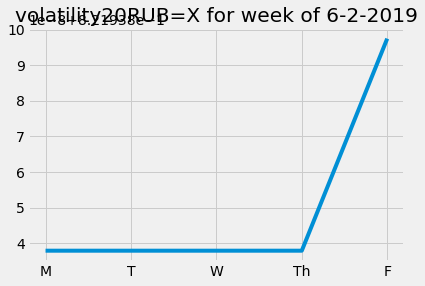

In [58]:
for t in list(ticker_lookup.keys()):
    plt.style.use('fivethirtyeight')
    plt.title(str(t)+" for week of "+str(now.month)+"-"+str(now.day)+"-"+str(now.year))
#     plt.plot([i[ticker_lookup[t]] for i in best_model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))])
    plt.plot([i[ticker_lookup[t]] for i in best_model.predict(x_test[-days:])])
    plt.xticks(np.arange(5), ('M', 'T', 'W', 'Th', 'F'))
    if "volatility" in t:
        plt.savefig('../reports/'+t.split("volatility")[1]+'_volatility_prediction.png')
    else:
        plt.savefig('../reports/'+t+'_prediction.png')
    plt.show()

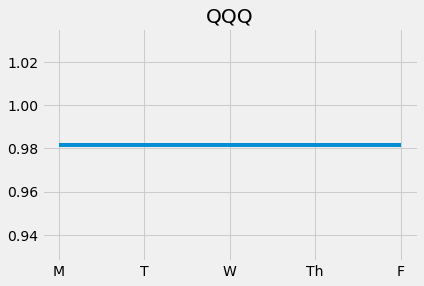

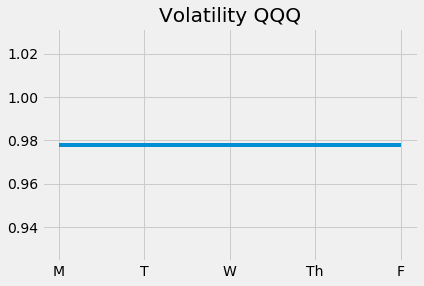

In [103]:
t = "QQQ"
plt.style.use('fivethirtyeight')
plt.title(t)
plt.plot([i[ticker_lookup[t]] for i in best_model.predict(x_test[-days:])])
# plt.plot([i[ticker_lookup[t]] for i in best_model.predict(np.reshape(data[-days:], (days, 1, data.shape[1])))])
plt.xticks(np.arange(5), ('M', 'T', 'W', 'Th', 'F'))
plt.show()

plt.title("Volatility "+t)
plt.plot([i[ticker_lookup["volatility"+t]] for i in best_model.predict(x_test[-days:])])
plt.xticks(np.arange(5), ('M', 'T', 'W', 'Th', 'F'))
plt.show()